In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torch.optim as optim

from torchvision.utils import make_grid

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
import os
os.chdir('../IConNet/')
os.getcwd()

'/home/linh/projects/IConNet'

In [5]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
import numpy as np
from tqdm import tqdm

In [9]:
data_dir = '../data/data_preprocessed/meld/features_4balanced/'
sr = 16000

data_x = np.load(f'{data_dir}meld.audio16k.npy', allow_pickle=True)
data_y = np.load(f'{data_dir}meld.label_emotion.npy', allow_pickle=True)
print(data_x.shape)
print(data_y.shape)
np.unique(data_y)

(8499,)
(8499,)


array([0, 1, 2, 3])

In [10]:
classnames = ['ang', 'hap', 'neu', 'sad']
labels = ['ang', 'neu', 'sad', 'hap']

def label_filter(idx):
    return classnames[idx] in labels

def label_to_index(idx):
    return labels.index(classnames[idx])
    
filtered_idx = [label_filter(idx) for idx in data_y]
data_x = data_x[filtered_idx]
data_y = [label_to_index(idx) for idx in data_y[filtered_idx]]
print(data_x.shape)

(8499,)


In [11]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(
    data_x, data_y, test_size=0.2, 
    random_state=42, stratify=data_y)
print("Train: %i" % len(x_train))
print("Test: %i" % len(x_test))

Train: 6799
Test: 1700


In [12]:
train_set = list(zip(x_train, y_train))
test_set = list(zip(x_test, y_test))

In [13]:
def pad_sequence(batch):
    # Make all tensor in a batch the same length by padding with zeros
    batch = [item.t() for item in batch]
    batch = torch.nn.utils.rnn.pad_sequence(
        batch, batch_first=True, padding_value=0.).permute(0, 2, 1)
    return batch

def collate_fn(batch, max_duration_in_second=3, sample_rate=sr):
    tensors, targets = [], []

    # Gather in lists, and encode labels as indices
    for waveform, label in batch:
        if max_duration_in_second is not None:
            waveform = np.array(waveform, dtype=float).squeeze()
            length = len(waveform)
            max_length = sample_rate * max_duration_in_second
            offset = max(0, (length - max_length) // 2)
            waveform = waveform[offset: length-offset]
        tensors += [torch.tensor(waveform, dtype=torch.float32)[None,:]]
        targets += [torch.tensor(label, dtype=torch.long)]

    # Group the list of tensors into a batched tensor
    tensors = pad_sequence(tensors)
    targets = torch.stack(targets)
    return tensors, targets

batch_size = 16

if device == "cuda":
    num_workers = 1
    pin_memory = True
else:
    num_workers = 0
    pin_memory = False

train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory, 
    drop_last=True
)
test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False,
    drop_last=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory
)

In [14]:
from IConNet.acov.zero_crossing import (
    zero_crossings, zero_crossing_rate, 
    zero_crossing_score, samples_like,
    signal_distortion_ratio, signal_loss)
from IConNet.nn.activation import gumbel_softmax

In [15]:
from einops import rearrange

class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost):
        super(VectorQuantizer, self).__init__()

        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings

        self.embedding = nn.Embedding(self.num_embeddings, self.embedding_dim)
        self.embedding.weight.data.uniform_(-1/self.num_embeddings, 1/self.num_embeddings)
        self.commitment_cost = commitment_cost

    def forward(self, inputs):
        eps = torch.finfo(inputs.dtype).eps
        device = inputs.device
        inputs = rearrange(inputs, 'b h c k -> b h c k')
        assert self.embedding_dim ==  inputs.shape[-1]

        flat_input = inputs.view(-1, self.embedding_dim)
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True)
                    + torch.sum(self.embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embedding.weight.t()))

        encoding_indices = torch.argmin(distances, dim=1, keepdim=True)
        encodings = torch.zeros(
            encoding_indices.shape[0], 
            self.num_embeddings, 
            device=device)
        encodings.scatter_(1, encoding_indices, 1)

        quantized = torch.matmul(
            encodings, self.embedding.weight).view(inputs.shape)

        e_latent_loss = F.mse_loss(quantized.detach(), inputs)
        q_latent_loss = F.mse_loss(quantized, inputs.detach())
        loss = q_latent_loss + self.commitment_cost * e_latent_loss

        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + eps)))
        return loss, quantized, perplexity, encodings

In [16]:
from typing import Literal
import torch 
from torch import nn, Tensor
from torch.nn import functional as F
from einops import rearrange, reduce, repeat

class LocalPatternFilter(nn.Module):
    def __init__(
        self, 
        in_channels: int, 
        out_channels: int, 
        kernel_size: int=1023,
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ) -> None:
        """
        filter_selection_mode:
            - `fixed`: linspace
            - `zerocrossing`: zerocrossing with gumbel softmax selection 
        """
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.kernel_size = kernel_size
        self.filter_selection_mode = filter_selection_mode
        self.position_concentration = nn.Parameter(torch.rand(self.out_channels))  
        self.pad_layer = PadForConv(
                    kernel_size=self.kernel_size,
                    pad_mode='zero')

    @staticmethod
    def compute_autocovariance(
            X: Tensor,
            positions,
            kernel_size) -> Tensor:
        acov = []
        for position in positions:
            end_pos = position + kernel_size
            frame = X[..., position:end_pos]
            acov += [self.autocovariance(frame)]
        return torch.stack(acov, dim=1)

    @staticmethod
    def autocovariance(filters: Tensor) -> Tensor:
        eps = torch.finfo(filters.dtype).eps
        n = filters.shape[-1]
        filters_max = reduce(filters.abs(), '... n -> ... ()', 'max')
        filters_max = torch.where(filters_max == 0, eps, filters_max)
        win = torch.hann_window(
            window_length=n, 
            dtype=filters.dtype, device=filters.device)
        windowed_data = filters * win / filters_max # normalize
        spectrum = torch.fft.rfft(windowed_data, n=n)**2
        acov = torch.fft.ifftshift(torch.fft.irfft(spectrum.abs(), n=n))
        return acov

    @staticmethod
    def random_filter_positions(
        X: Tensor,
        n_positions: int,
        kernel_size: int,
        end: int,
        mode: Literal['fixed', 'auto']='fixed',
    ):
        if mode=='fixed':
            positions = repeat(
                torch.linspace(
                    start=0, 
                    end=end,
                    steps=n_positions,
                    dtype=torch.int,
                    device=X.device),
                'h -> b h', b=X.shape[0]
            )
        else: # auto: based on zerocrossing
            scores = zero_crossing_score(
                X, n_fft=kernel_size, stride=kernel_size//4)
            scores = gumbel_softmax(scores, tau=1)
            samples = samples_like(
                scores, 
                n_fft=kernel_size, 
                stride=kernel_size//4,
                offset=0, 
                max_sample=end,
                keepdim=False) # (T)
            
            frame_positions = torch.topk(
                scores, n_positions, dim=-1).indices.sort().values
            
            positions = []
            for frame_pos in frame_positions.split(1):
                frame_pos = frame_pos.squeeze()
                positions += [samples.index_select(dim=0, index=frame_pos)]
            positions = torch.stack(positions, dim=0) 
        return positions.contiguous()

    def _generate_filters_idx(self, X: Tensor) -> Tensor:
        length = X.shape[-1]
        end = length - self.kernel_size - 1 - self.kernel_size # TODO: check why -kernel
        n_positions = self.out_channels
        positions = self.random_filter_positions(
            X, n_positions, self.kernel_size,
            end, self.filter_selection_mode)
        positions = rearrange(positions, '... t -> ... t 1')
        filters_idx = torch.concat(
            [positions + i for i in range(self.kernel_size)], 
            dim=-1)
        # print(f'X: {X.shape} | filters_idx: [{filters_idx.min()}, {filters_idx.max()}]')
        return filters_idx

    # def _extract_filters(
    #     self, X: Tensor, filters_idx: Tensor) -> Tensor:
    #     filters = []
    #     z = torch.zeros(
    #         filters_idx.shape[0], filters_idx.shape[1],
    #         X.shape[-1] - self.kernel_size, device=X.device)
    #     filters_idx = torch.concat([filters_idx, z], dim=-1).type(torch.int64)
    #     for idx in filters_idx.split(1, dim=1):
    #         indices = repeat(idx, 'b 1 n -> b c n', c=self.in_channels)
    #         f = torch.gather(
    #             X, dim=-1, index=indices, 
    #             sparse_grad=False)[...,:self.kernel_size]
    #         filters.append(f)
    #     filters = torch.stack(filters, dim=1).contiguous()
    #     return filters

    def _extract_filters(
        self, X: Tensor, filters_idx: Tensor) -> Tensor:
        filters = []
        b, h, n = filters_idx.shape
        for i in range(b):
            filter = []
            for j in range(h):
                filter += [X[i].index_select(dim=-1, index=filters_idx[i, j, :])]
            filter = torch.stack(filter, dim=0)
            filters.append(filter)
        filters = torch.stack(filters, dim=0).contiguous()
        return filters
        
    def _generate_filters(self, X) -> Tensor:
        filters_idx = self._generate_filters_idx(self.pad_layer(X))
        filters = self._extract_filters(X, filters_idx)
        filters = self.autocovariance(filters)
        return filters
    
    def forward(self, X: Tensor) -> Tensor:
        batch_size = X.shape[0]
        filters = self._generate_filters(X)
        assert filters.shape == (batch_size,
                                 self.out_channels, 
                                 self.in_channels, 
                                 self.kernel_size)
        return filters

    

In [17]:
class FilterEnhance(nn.Module):
    def __init__(
        self, 
        in_channels,
        out_channels):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        
    def forward(self, X, filters):
        recon_loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
        n_outputs = self.out_channels
        n_batch = X.shape[0]
        for i in range(n_batch):
            X_outs = F.conv1d(
                X, filters[i], padding='same').chunk(n_outputs, dim=1)
            loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
            for k in range(n_outputs):
                loss = loss + signal_loss(X, X_outs[k])
            recon_loss = recon_loss + loss / n_outputs
        return recon_loss.sum()

In [18]:
from IConNet.conv.pad import PadForConv
from IConNet.nn.mamba import FeedForward, MambaBlock

In [19]:
num_training_updates = 1000
log_interval = 100
test_interval = 100

in_channels = 1
out_channels = 8
embedding_dim = 1023
num_embeddings = 384

commitment_cost = 0.25

learning_rate = 1e-3
num_tokens = 8
num_classes = 4

In [20]:
class Model(nn.Module):
    def __init__(
        self,
        in_channels: int, 
        out_channels: int,         
        num_embeddings: int, 
        embedding_dim: int, 
        commitment_cost: float,
        num_tokens: int, 
        num_classes: int, 
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ):
        super(Model, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.num_embeddings = num_embeddings
        self.embedding_dim = embedding_dim
        self.num_tokens = num_tokens
        self.cls_features = num_embeddings
        self.num_classes = num_classes

        self.encoder = LocalPatternFilter(
            in_channels = in_channels,
            out_channels = out_channels,
            filter_selection_mode=filter_selection_mode
        )
        self.vq_vae = VectorQuantizer(
            num_embeddings, embedding_dim, commitment_cost)
        self.decoder = FilterEnhance(
            in_channels = in_channels,
            out_channels = out_channels
        )
        self.ffn = FeedForward(self.num_embeddings)
        self.ln1 = nn.LayerNorm(self.num_embeddings)
        self.cls_head = nn.Linear(
            self.cls_features, num_classes)
        self.pad_layer = PadForConv(
                    kernel_size=self.num_tokens,
                    pad_mode='mean')

    def project(self, X):
        filters = repeat(
            self.vq_vae.embedding.weight,
            'h n -> h c n', c=self.in_channels)
        X = F.conv1d(X, filters)
        return X

    def classify(self, X):
        X = reduce(rearrange(self.pad_layer(X), 
                      'b h (l t) -> b l t h', l=self.num_tokens),
                  'b l t h -> b l h', 'max')
        X = reduce(self.ffn(self.ln1(X)),
                     'b l h -> b h', 'mean')
        X = self.cls_head(X)
        return X

    def forward(self, X):
        Z = self.encoder(X)
        vq_loss, Z_quantized, perplexity, _ = self.vq_vae(Z)
        recon_loss = self.decoder(X, Z_quantized)
        logits = self.classify(self.project(X))
        return logits, vq_loss, recon_loss, perplexity

In [21]:
model = Model(in_channels, out_channels,
              num_embeddings, embedding_dim,
              commitment_cost, num_tokens, 
              num_classes, filter_selection_mode='auto').to(device)

In [22]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, amsgrad=False)

In [23]:
test_loader_length = len(test_loader.dataset)

@torch.no_grad()
def test(model, iter):
    model.eval()
    correct = 0
    for data, target in test_loader:
        data = data.to(device)
        target = target.to(device)
        logits, _,_,_ = model(data)
        del data
        gc.collect()
        torch.cuda.empty_cache()
        probs = F.softmax(logits.squeeze(), dim=-1)
        pred = probs.argmax(dim=-1)
        correct += pred.eq(target).sum().item()
        del target
        gc.collect()
        torch.cuda.empty_cache()
    acc = correct / test_loader_length
    print(f"Test iter: {iter}\tAccuracy: {correct}/{test_loader_length} ({100. * acc:.0f}%)\n")
    return acc

In [24]:
model.train()
train_res_recon_error = []
train_res_perplexity = []
train_res_cls_loss = []
test_accuracy = []

for i in range(num_training_updates):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.15*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()

    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        model.train()
        

100 iterations
cls_loss: 1.177
recon_error: 49.545
perplexity: 17.211

Test iter: 100	Accuracy: 939/1700 (55%)

200 iterations
cls_loss: 1.131
recon_error: 48.827
perplexity: 16.447

Test iter: 200	Accuracy: 942/1700 (55%)

300 iterations
cls_loss: 1.131
recon_error: 49.322
perplexity: 16.510

Test iter: 300	Accuracy: 922/1700 (54%)

400 iterations
cls_loss: 1.155
recon_error: 49.477
perplexity: 17.365

Test iter: 400	Accuracy: 930/1700 (55%)

500 iterations
cls_loss: 1.149
recon_error: 50.206
perplexity: 17.442

Test iter: 500	Accuracy: 941/1700 (55%)

600 iterations
cls_loss: 1.111
recon_error: 50.319
perplexity: 17.340

Test iter: 600	Accuracy: 943/1700 (55%)

700 iterations
cls_loss: 1.114
recon_error: 49.345
perplexity: 17.256

Test iter: 700	Accuracy: 945/1700 (56%)

800 iterations
cls_loss: 1.107
recon_error: 50.380
perplexity: 17.214

Test iter: 800	Accuracy: 951/1700 (56%)

900 iterations
cls_loss: 1.117
recon_error: 48.351
perplexity: 17.674

Test iter: 900	Accuracy: 943/1700

In [25]:
from IConNet.acov.visualize import (
    visualize_speech_codebook, get_embedding_color, 
    visualize_embedding_umap, visualize_training_curves
)

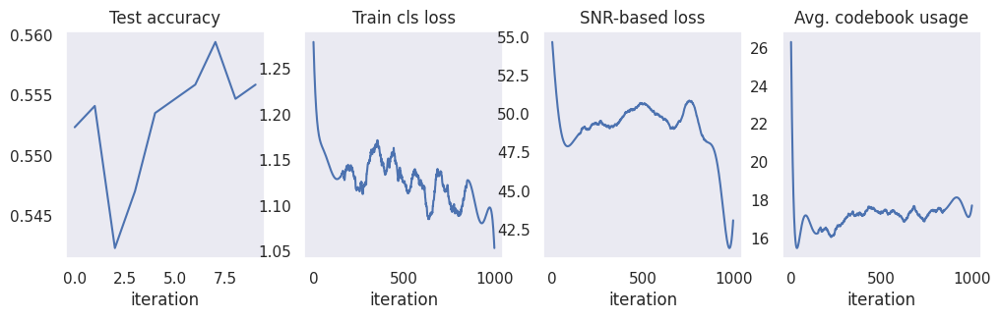

In [26]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [27]:
emb_data = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data)

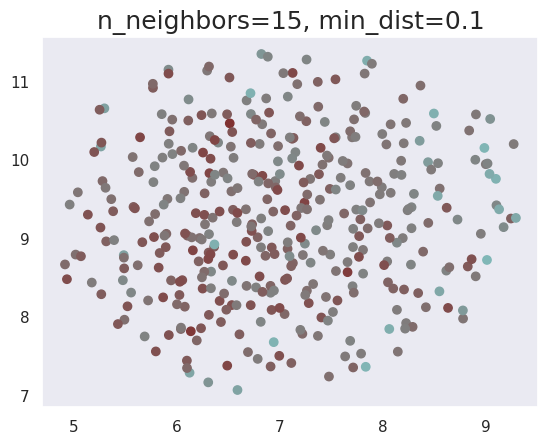

In [28]:
k = 15
min_dist=0.1
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

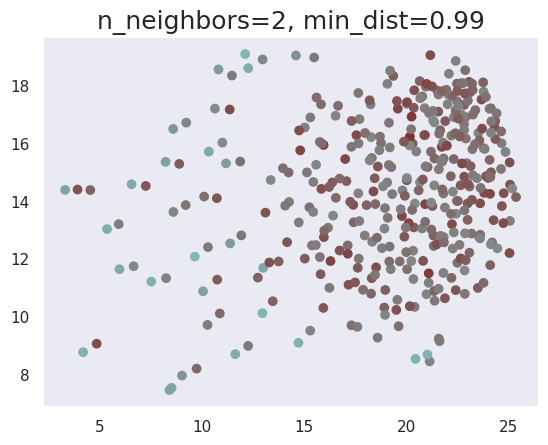

In [29]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

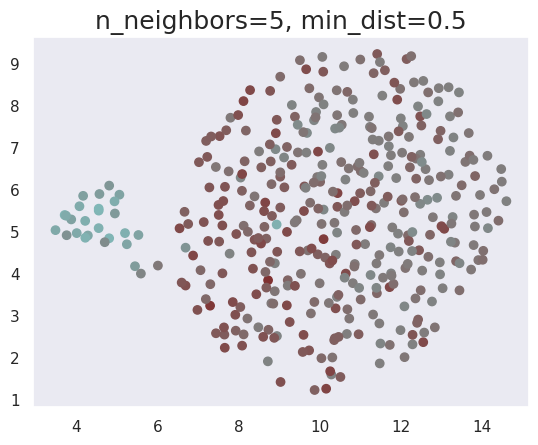

In [30]:
k = 5
min_dist=0.5
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

/opt/anaconda3/envs/audio/lib/python3.9/site-packages/librosa/feature/spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


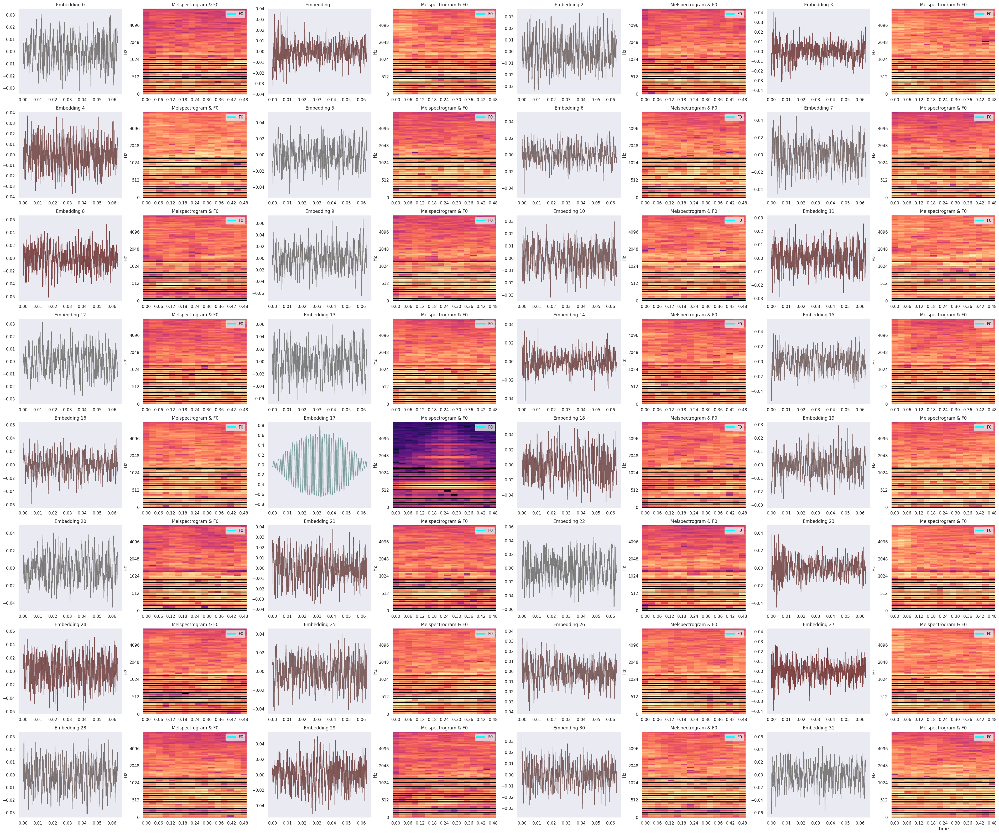

In [31]:
visualize_speech_codebook(emb_data.numpy(), n=64, colors=emb_color)

In [32]:
torch.topk(zcs, 32)

torch.return_types.topk(
values=tensor([0.7194, 0.7098, 0.7098, 0.7000, 0.6976, 0.6926, 0.6901, 0.6888, 0.6825,
        0.6800, 0.6723, 0.6697, 0.6645, 0.6619, 0.6566, 0.6486, 0.6405, 0.6378,
        0.6324, 0.6269, 0.6117, 0.6103, 0.6047, 0.5892, 0.5807, 0.5706, 0.5504,
        0.5490, 0.5475, 0.5475, 0.5446, 0.5431]),
indices=tensor([206,  74,  33, 257, 291, 241, 264, 259, 119, 194, 369, 163, 344, 383,
        262, 267, 283, 133, 225,  17,  58, 160, 326, 332, 305,  32,  49, 266,
        276, 363,  40, 361]))

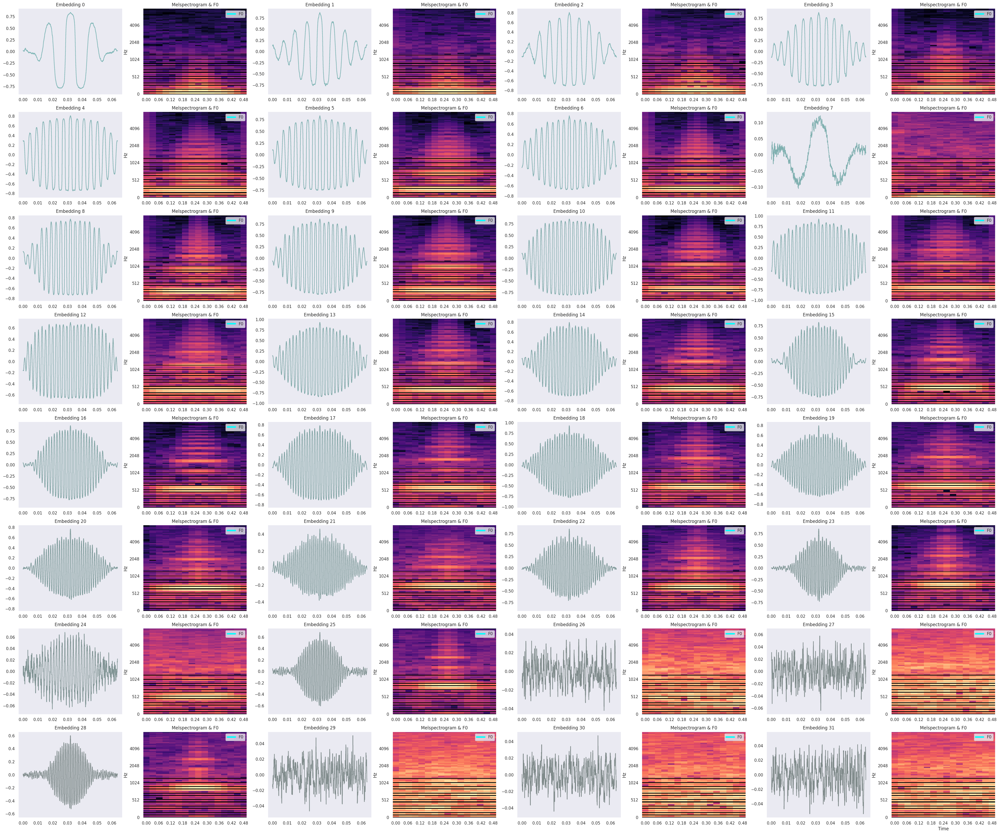

In [33]:
selected_emb_topk = torch.topk(zcs, 32)
selected_emb = emb_data.index_select(dim=0, index=selected_emb_topk.indices)
selected_emb_color = torch.stack(
        [torch.full_like(selected_emb_topk.values, 0.5), 
         selected_emb_topk.values, selected_emb_topk.values], 
        dim=-1).numpy()
visualize_speech_codebook(selected_emb.numpy(), n=64, colors=selected_emb_color)

In [34]:
from IConNet.acov.audio import AudioLibrosa

In [35]:
selected_emb_np = selected_emb.numpy()

In [36]:
from IPython.display import display

In [37]:
selected_voiced_idx = selected_emb_topk.indices
selected_voiced_idx

tensor([206,  74,  33, 257, 291, 241, 264, 259, 119, 194, 369, 163, 344, 383,
        262, 267, 283, 133, 225,  17,  58, 160, 326, 332, 305,  32,  49, 266,
        276, 363,  40, 361])

In [38]:
emb_np = emb_data.numpy()
for i in selected_voiced_idx:
    title=f'Voiced Embedding {i}'
    top_audio = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(title)
    display(top_audio.player)

Voiced Embedding 206


Voiced Embedding 74


Voiced Embedding 33


Voiced Embedding 257


Voiced Embedding 291


Voiced Embedding 241


Voiced Embedding 264


Voiced Embedding 259


Voiced Embedding 119


Voiced Embedding 194


Voiced Embedding 369


Voiced Embedding 163


Voiced Embedding 344


Voiced Embedding 383


Voiced Embedding 262


Voiced Embedding 267


Voiced Embedding 283


Voiced Embedding 133


Voiced Embedding 225


Voiced Embedding 17


Voiced Embedding 58


Voiced Embedding 160


Voiced Embedding 326


Voiced Embedding 332


Voiced Embedding 305


Voiced Embedding 32


Voiced Embedding 49


Voiced Embedding 266


Voiced Embedding 276


Voiced Embedding 363


Voiced Embedding 40


Voiced Embedding 361


In [39]:
from IConNet.acov.audio_viz import (
    feature_librosa, play_and_visualize, show_feature)

def display_embedding(i, title_prefix="Voiced "):
    title=f'{title_prefix}Embedding {i}'
    audio_top = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        win_length=256
    )
    audio_top.extract_features()
    print(title)
    show_feature(audio_top)
    display(audio_top.player)

Voiced Embedding 206



Voiced Embedding 74



Voiced Embedding 33



Voiced Embedding 257



Voiced Embedding 291



Voiced Embedding 241



Voiced Embedding 264



Voiced Embedding 259



Voiced Embedding 119



Voiced Embedding 194



Voiced Embedding 369



Voiced Embedding 163



Voiced Embedding 344



Voiced Embedding 383



Voiced Embedding 262



Voiced Embedding 267



Voiced Embedding 283



Voiced Embedding 133



Voiced Embedding 225



Voiced Embedding 17



Voiced Embedding 58



Voiced Embedding 160



Voiced Embedding 326



Voiced Embedding 332



Voiced Embedding 305



Voiced Embedding 32



Voiced Embedding 49



Voiced Embedding 266



Voiced Embedding 276



Voiced Embedding 363



Voiced Embedding 40



Voiced Embedding 361



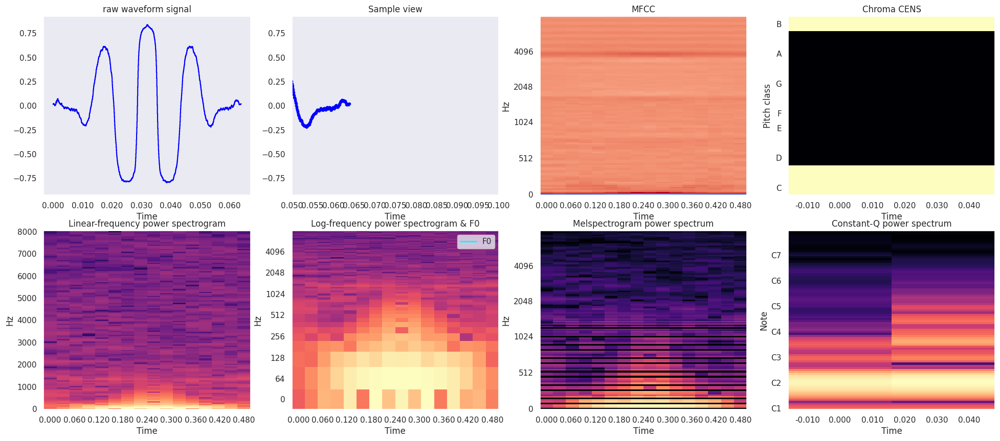

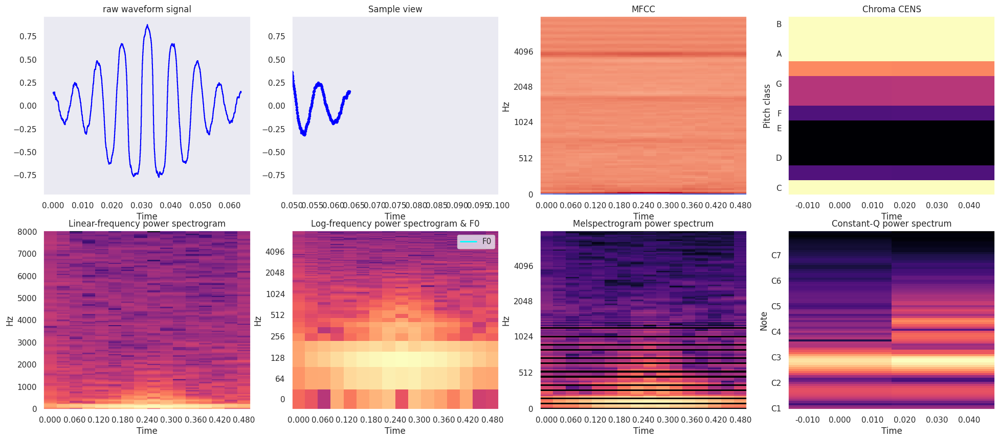

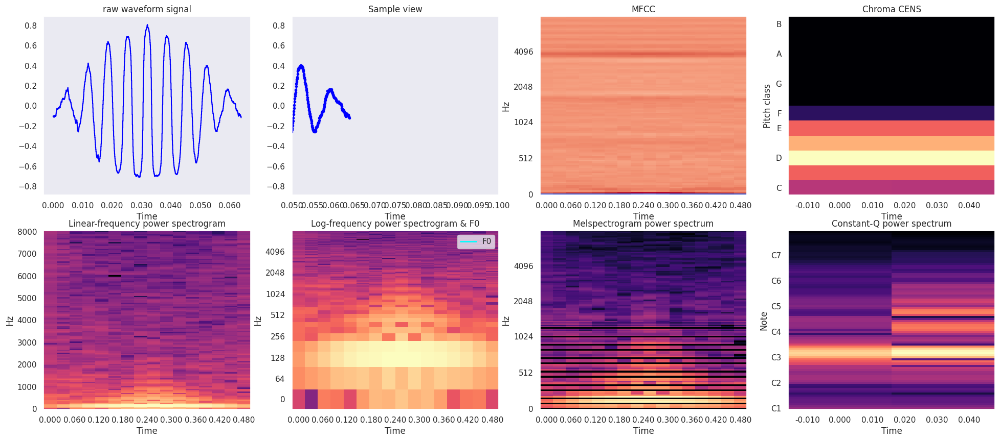

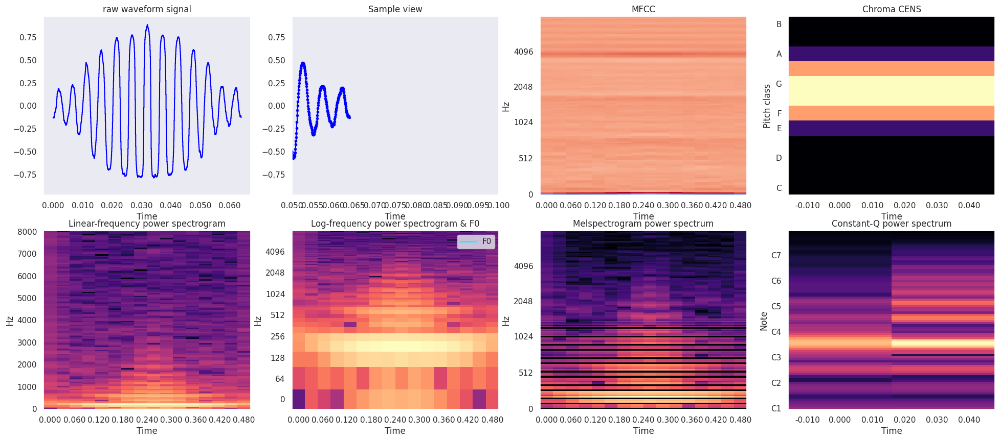

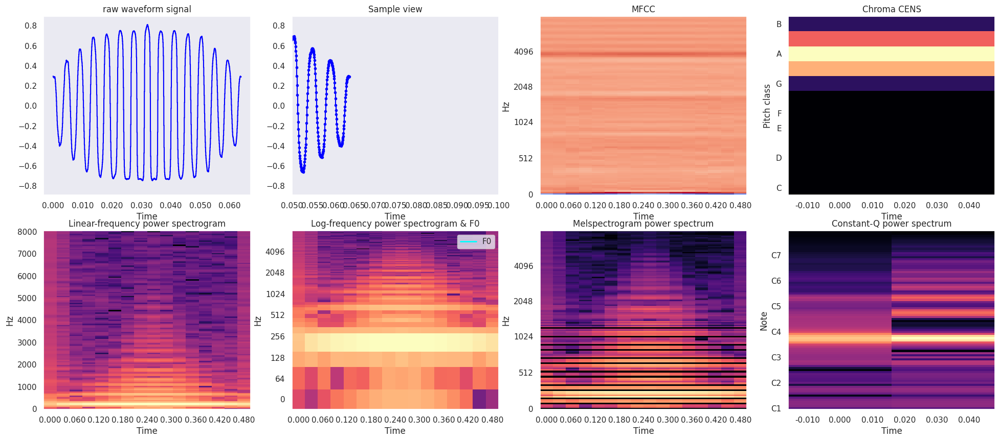

...

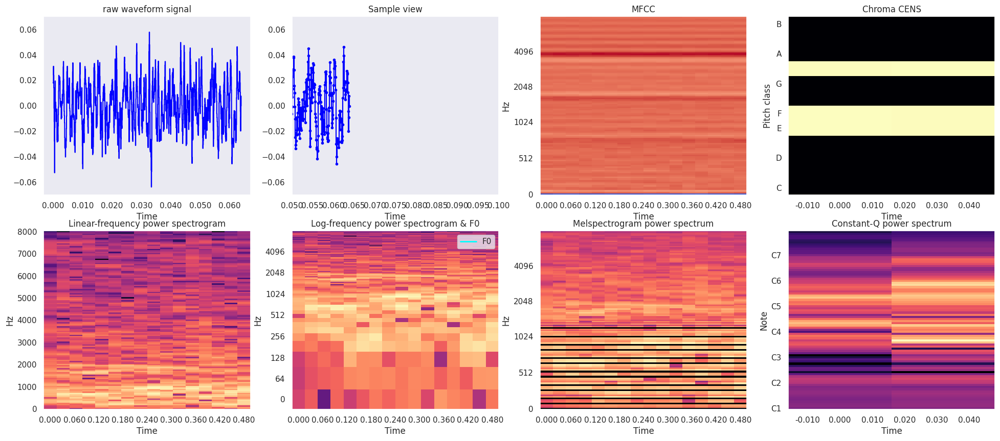

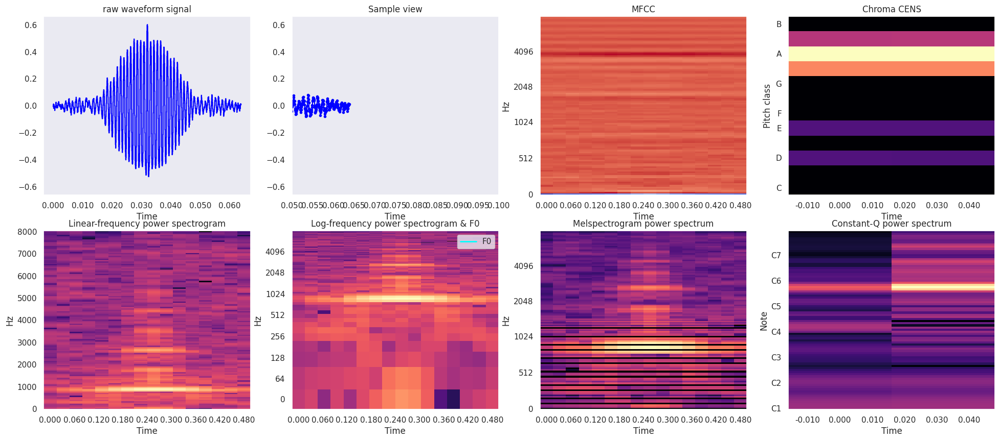

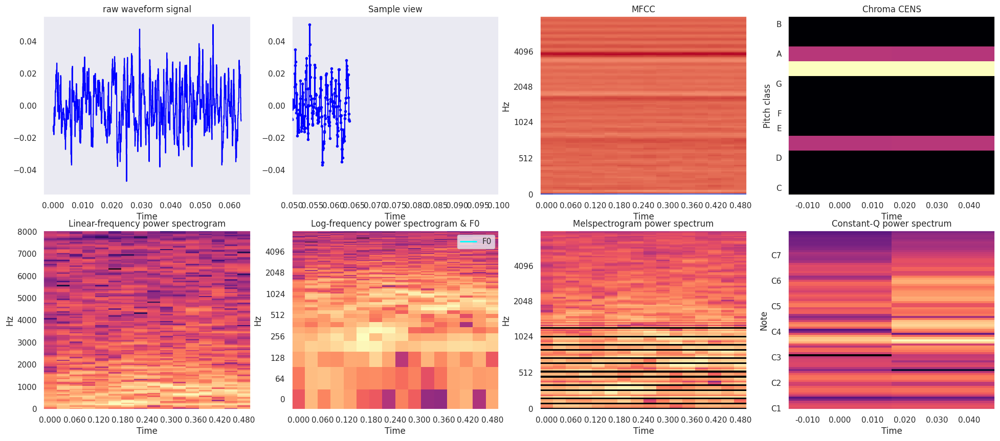

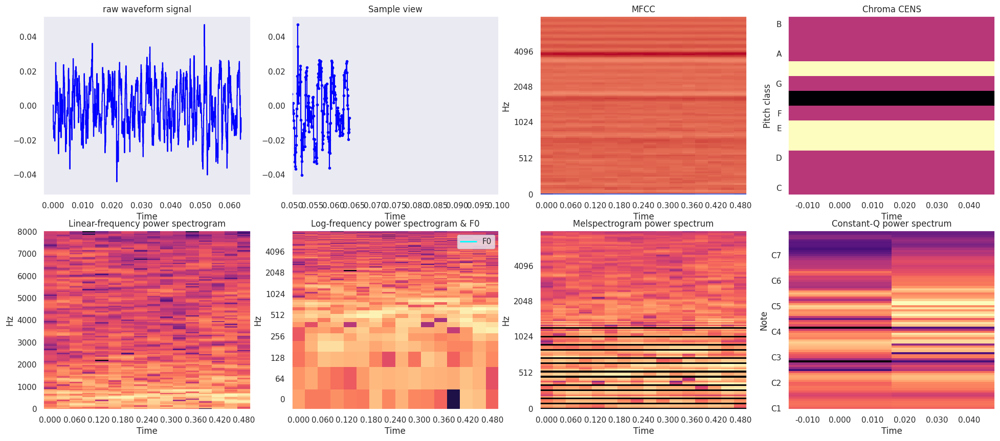

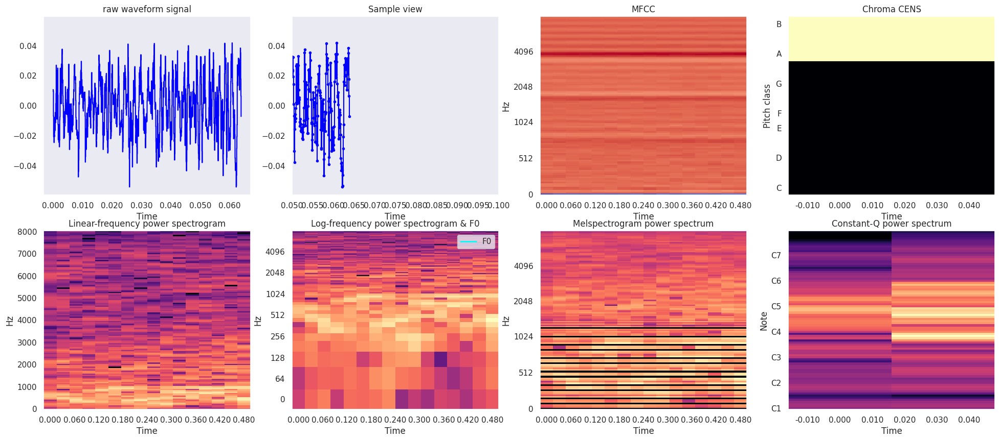

In [40]:
for ii in range(32):
    display_embedding(selected_voiced_idx[ii])

In [41]:
best_acc = 0.5

In [42]:
num_training_updates = 1000
additional_steps = 1700
for i in range(num_training_updates, num_training_updates+additional_steps):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.1*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()
    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        model.train()

        if best_acc < acc:
            best_acc = acc
            model_path = f'../linh_scb6.model.meld.step{i+1}.pt'
            torch.save(model.state_dict(), model_path)
        

1100 iterations
cls_loss: 1.126
recon_error: 42.419
perplexity: 18.005

Test iter: 1100	Accuracy: 948/1700 (56%)

1200 iterations
cls_loss: 1.110
recon_error: 43.885
perplexity: 18.861

Test iter: 1200	Accuracy: 887/1700 (52%)

1300 iterations
cls_loss: 1.114
recon_error: 46.650
perplexity: 18.123

Test iter: 1300	Accuracy: 953/1700 (56%)

1400 iterations
cls_loss: 1.135
recon_error: 45.893
perplexity: 18.646

Test iter: 1400	Accuracy: 948/1700 (56%)

1500 iterations
cls_loss: 1.113
recon_error: 46.800
perplexity: 18.637

Test iter: 1500	Accuracy: 949/1700 (56%)

1600 iterations
cls_loss: 1.074
recon_error: 46.816
perplexity: 18.578

Test iter: 1600	Accuracy: 942/1700 (55%)

1700 iterations
cls_loss: 1.123
recon_error: 45.609
perplexity: 18.564

Test iter: 1700	Accuracy: 940/1700 (55%)

1800 iterations
cls_loss: 1.124
recon_error: 44.878
perplexity: 18.649

Test iter: 1800	Accuracy: 937/1700 (55%)

1900 iterations
cls_loss: 1.122
recon_error: 43.987
perplexity: 19.026

Test iter: 1900	

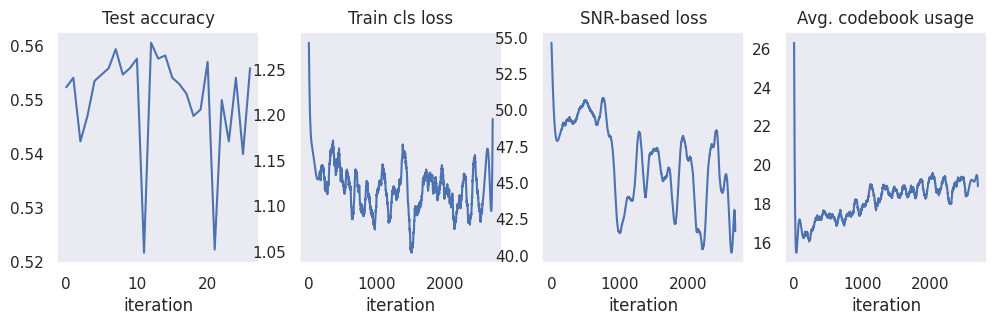

In [43]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [44]:
emb_data2 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data2)

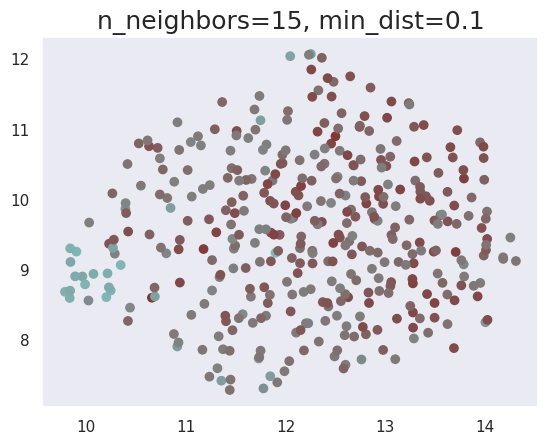

In [45]:
k = 15
min_dist=0.1
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

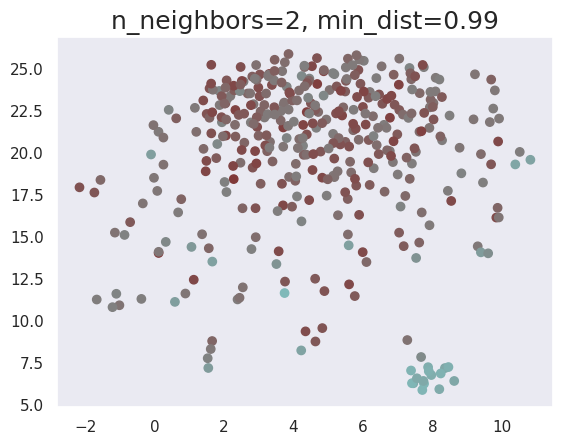

In [46]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

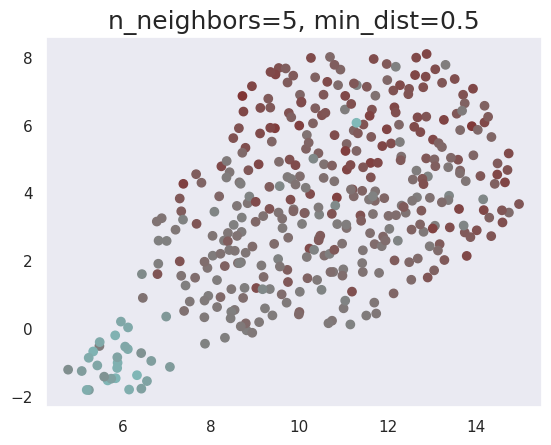

In [47]:
k = 5
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

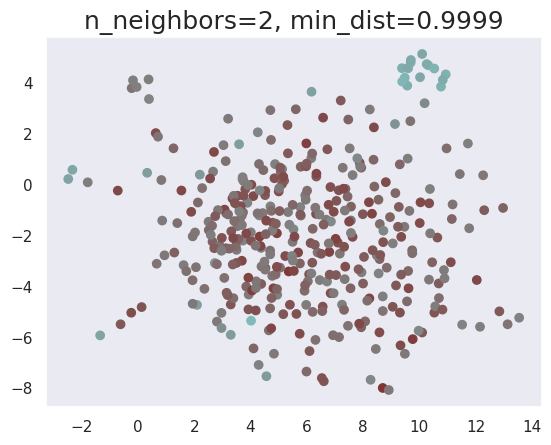

In [48]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='minkowski', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

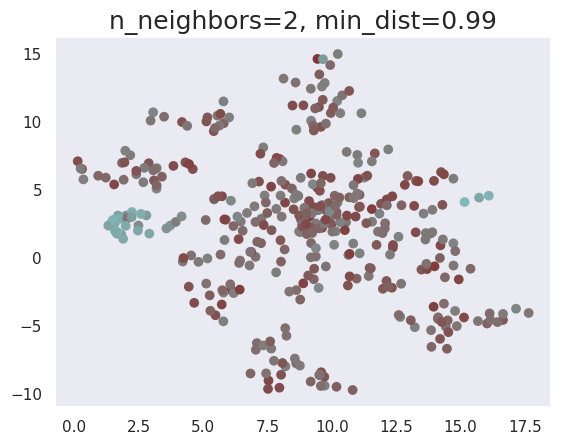

In [49]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

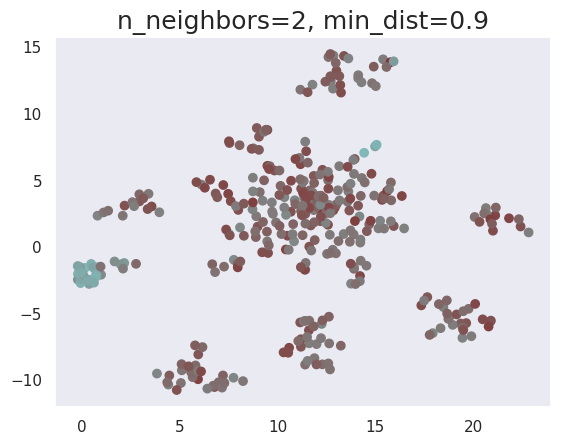

In [50]:
k = 2
min_dist=0.9
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

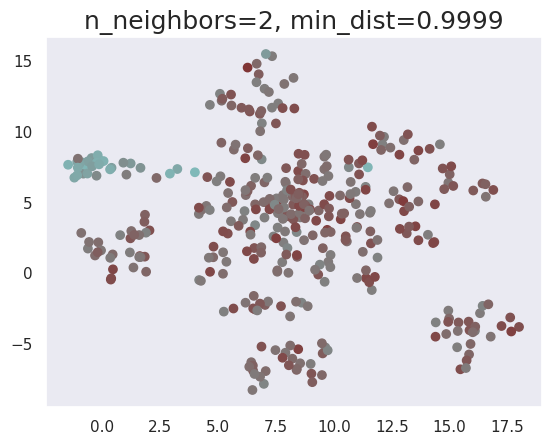

In [51]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

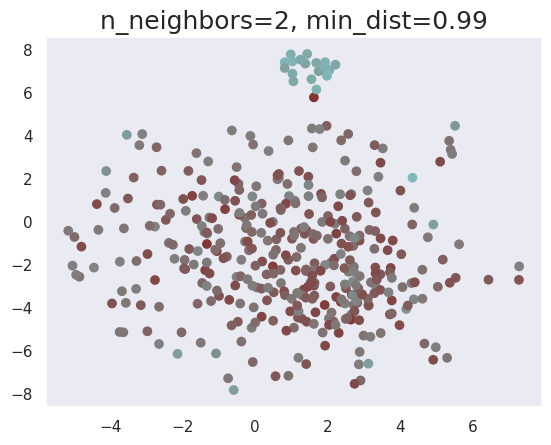

In [52]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='manhattan', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

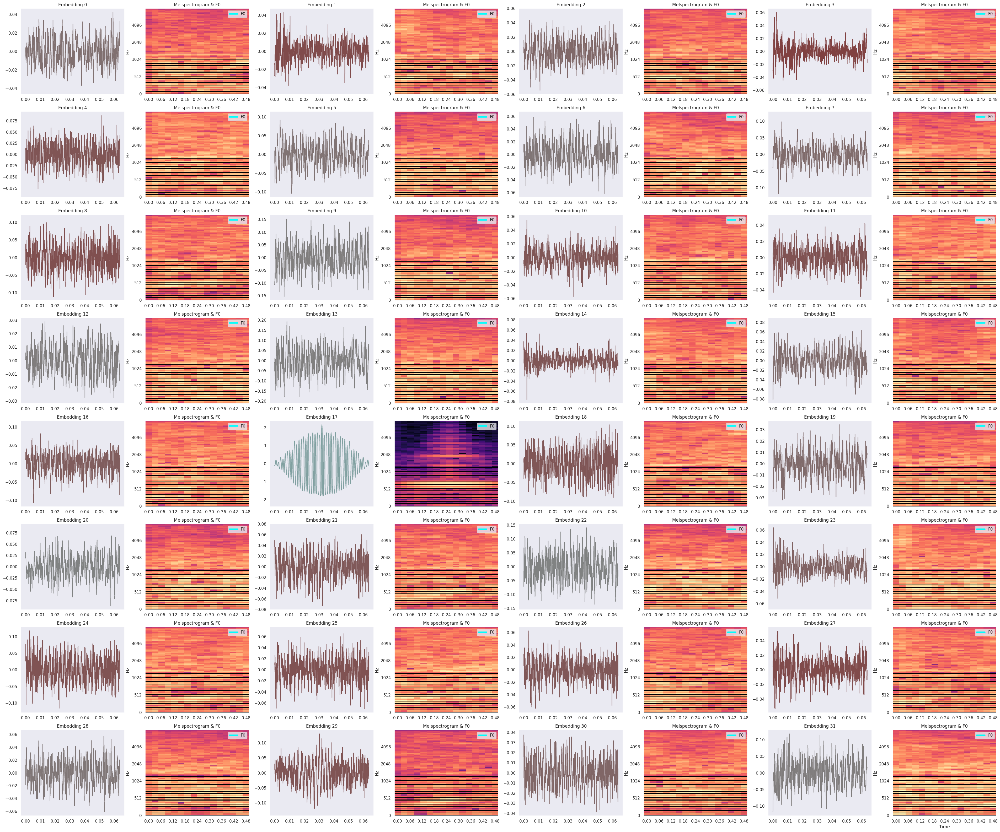

In [53]:
visualize_speech_codebook(emb_data2.numpy(), n=64, colors=emb_color)

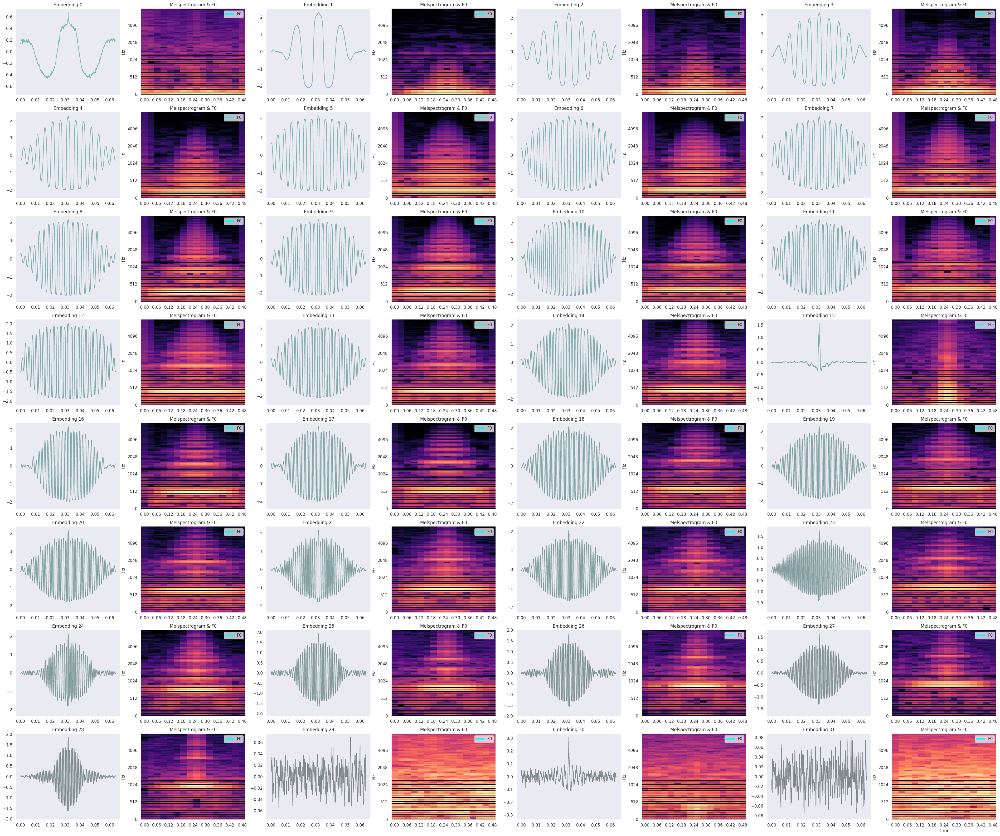

In [54]:
selected_emb_topk2 = torch.topk(zcs, 32)
selected_voiced_idx2 = selected_emb_topk2.indices
selected_emb2 = emb_data2.index_select(dim=0, index=selected_voiced_idx2)
selected_emb_color2 = torch.stack(
        [torch.full_like(selected_emb_topk2.values, 0.5), 
         selected_emb_topk2.values, selected_emb_topk2.values], 
        dim=-1).numpy()
visualize_speech_codebook(selected_emb2.numpy(), n=64, colors=selected_emb_color2)

In [55]:
emb_np2 = emb_data2.numpy()
for i in selected_voiced_idx2:
    title=f'Voiced Embedding {i}'
    top_audio = AudioLibrosa(
        y=emb_np2[i], 
        sr=sr, title=title,
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(title)
    display(top_audio.player)

Voiced Embedding 259


Voiced Embedding 206


Voiced Embedding 74


Voiced Embedding 33


Voiced Embedding 257


Voiced Embedding 291


Voiced Embedding 241


Voiced Embedding 264


Voiced Embedding 119


Voiced Embedding 194


Voiced Embedding 369


Voiced Embedding 163


Voiced Embedding 344


Voiced Embedding 383


Voiced Embedding 262


Voiced Embedding 56


Voiced Embedding 267


Voiced Embedding 283


Voiced Embedding 133


Voiced Embedding 225


Voiced Embedding 17


Voiced Embedding 326


Voiced Embedding 58


Voiced Embedding 160


Voiced Embedding 332


Voiced Embedding 32


Voiced Embedding 276


Voiced Embedding 51


Voiced Embedding 325


Voiced Embedding 187


Voiced Embedding 45


Voiced Embedding 363


Voiced Embedding 259



Voiced Embedding 206



Voiced Embedding 74



Voiced Embedding 33



Voiced Embedding 257



Voiced Embedding 291



Voiced Embedding 241



Voiced Embedding 264



Voiced Embedding 119



Voiced Embedding 194



Voiced Embedding 369



Voiced Embedding 163



Voiced Embedding 344



Voiced Embedding 383



Voiced Embedding 262



Voiced Embedding 56



Voiced Embedding 267



Voiced Embedding 283



Voiced Embedding 133



Voiced Embedding 225



Voiced Embedding 17



Voiced Embedding 326



Voiced Embedding 58



Voiced Embedding 160



Voiced Embedding 332



Voiced Embedding 32



Voiced Embedding 276



Voiced Embedding 51



Voiced Embedding 325



Voiced Embedding 187



Voiced Embedding 45



Voiced Embedding 363



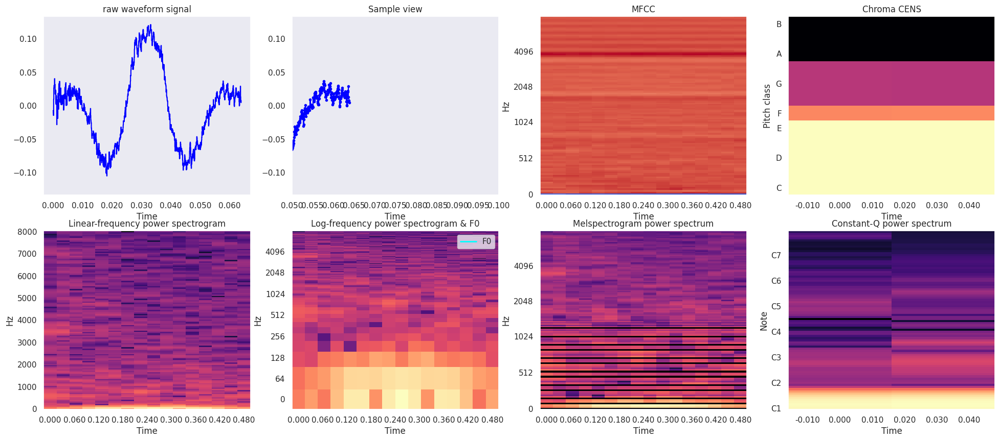

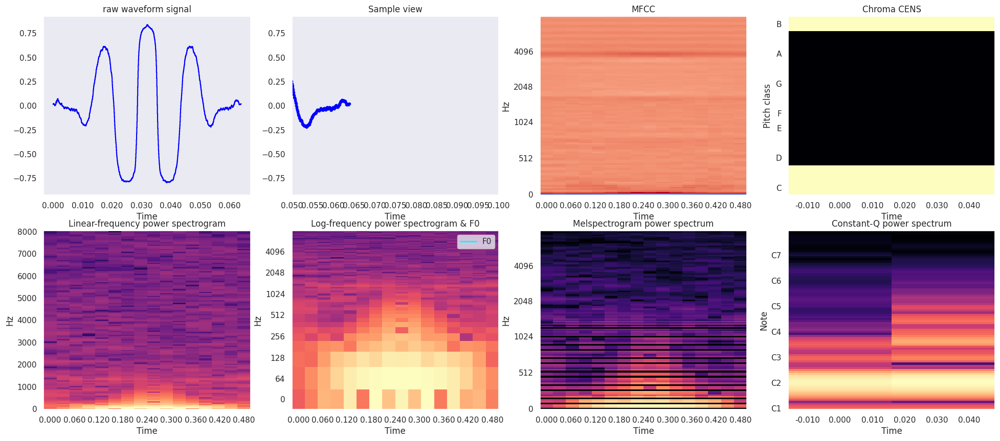

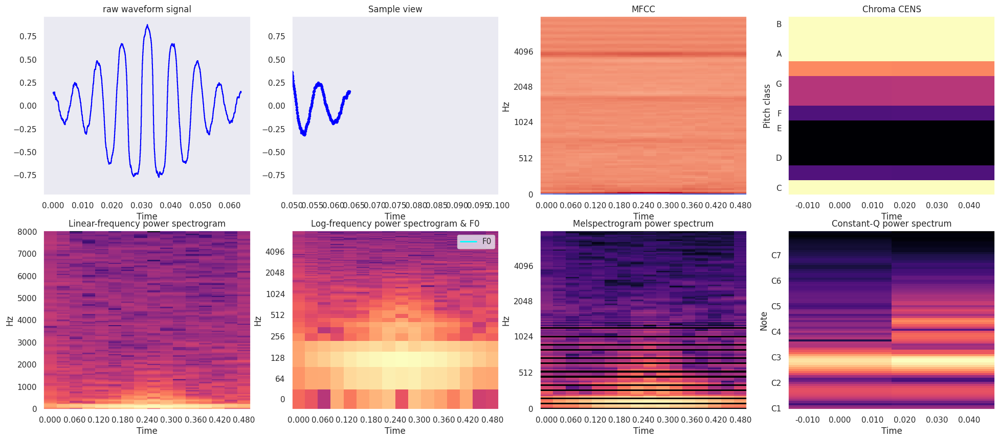

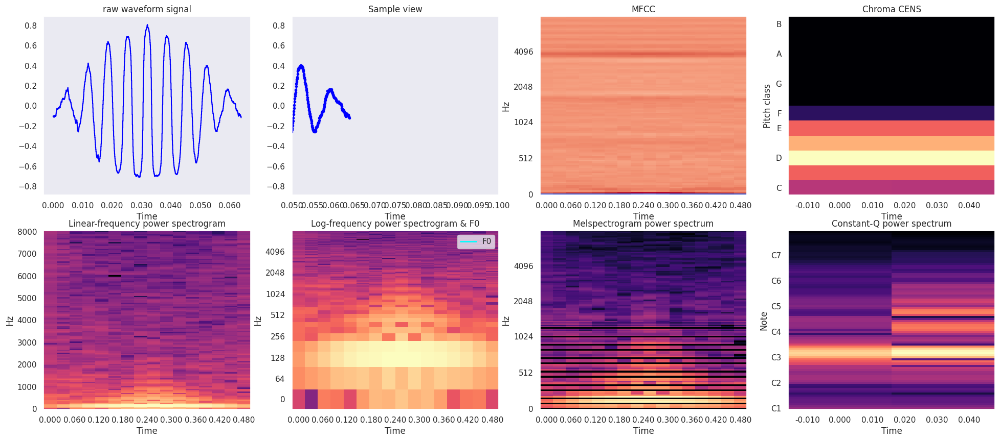

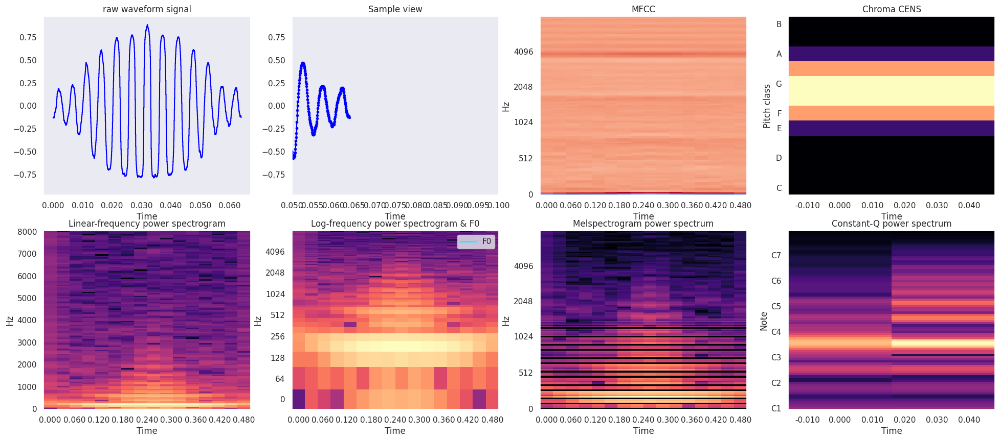

...

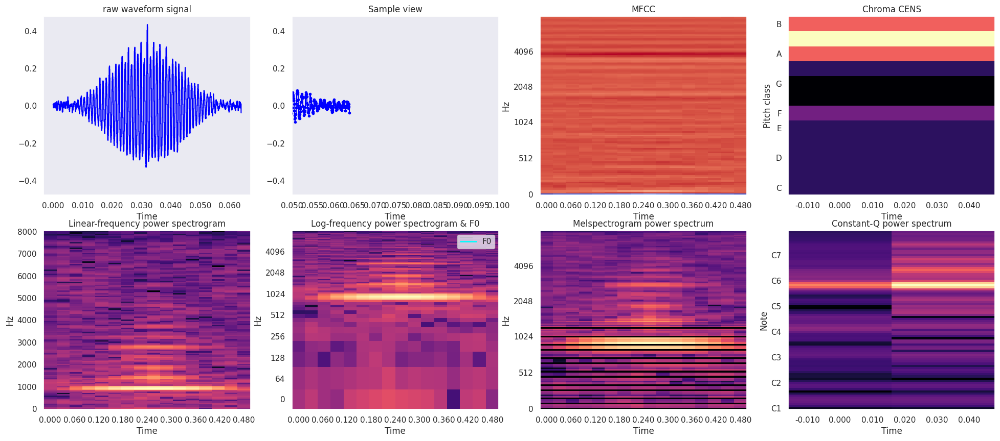

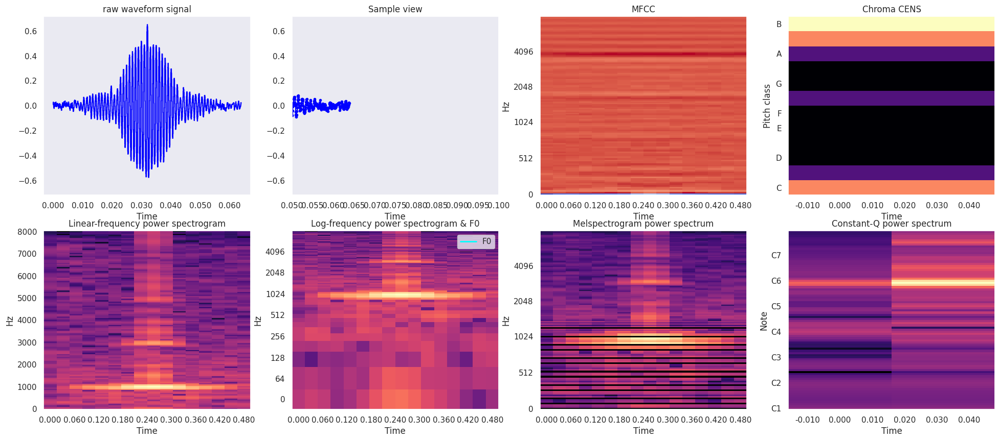

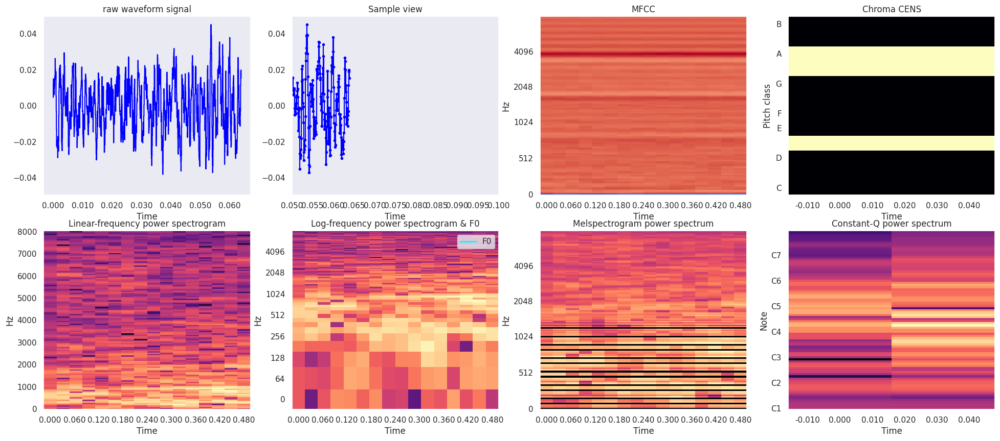

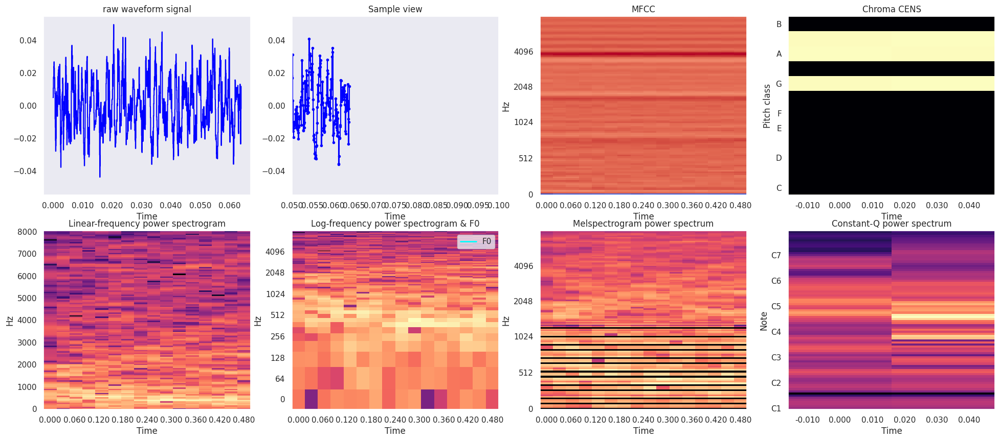

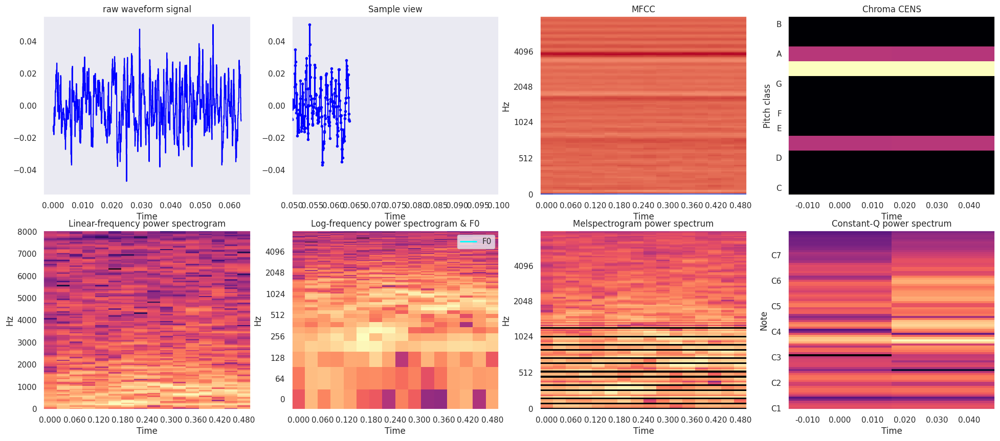

In [58]:
for ii in range(32):
    display_embedding(selected_voiced_idx2[ii])

In [59]:
num_training_updates = 2700
additional_steps = 9300
for i in range(num_training_updates, num_training_updates+additional_steps):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.1*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()
    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        model.train()

        if best_acc < acc:
            best_acc = acc
            model_path = f'../linh_scb6.model.meld.step{i+1}.pt'
            torch.save(model.state_dict(), model_path)
        

2800 iterations
cls_loss: 1.121
recon_error: 46.081
perplexity: 18.823

Test iter: 2800	Accuracy: 933/1700 (55%)

2900 iterations
cls_loss: 1.127
recon_error: 41.182
perplexity: 19.133

Test iter: 2900	Accuracy: 943/1700 (55%)

3000 iterations
cls_loss: 1.082
recon_error: 39.832
perplexity: 19.358

Test iter: 3000	Accuracy: 938/1700 (55%)

3100 iterations
cls_loss: 1.063
recon_error: 42.796
perplexity: 19.158

Test iter: 3100	Accuracy: 852/1700 (50%)

3200 iterations
cls_loss: 1.067
recon_error: 44.224
perplexity: 19.328

Test iter: 3200	Accuracy: 946/1700 (56%)

3300 iterations
cls_loss: 1.095
recon_error: 43.552
perplexity: 19.407

Test iter: 3300	Accuracy: 932/1700 (55%)

3400 iterations
cls_loss: 1.073
recon_error: 42.307
perplexity: 19.120

Test iter: 3400	Accuracy: 922/1700 (54%)

3500 iterations
cls_loss: 1.058
recon_error: 42.948
perplexity: 19.023

Test iter: 3500	Accuracy: 919/1700 (54%)

3600 iterations
cls_loss: 1.076
recon_error: 44.583
perplexity: 19.089

Test iter: 3600	

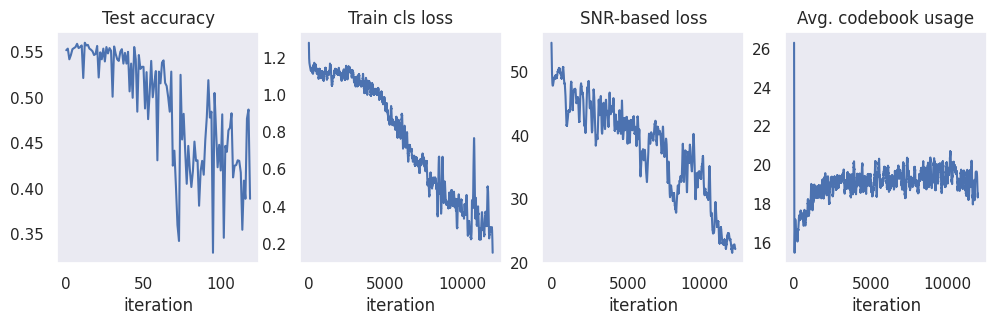

In [60]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

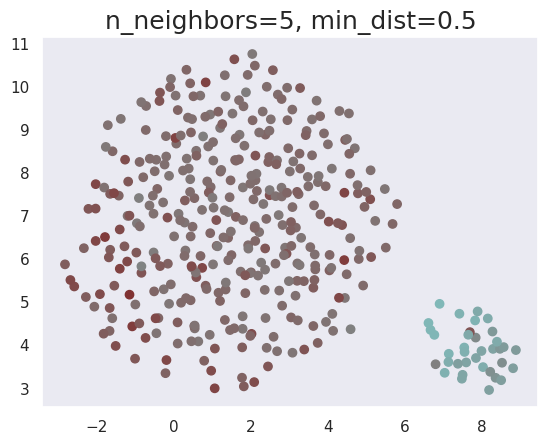

In [61]:
emb_data3 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data3)
k = 5
min_dist=0.5
visualize_embedding_umap(emb_data3, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

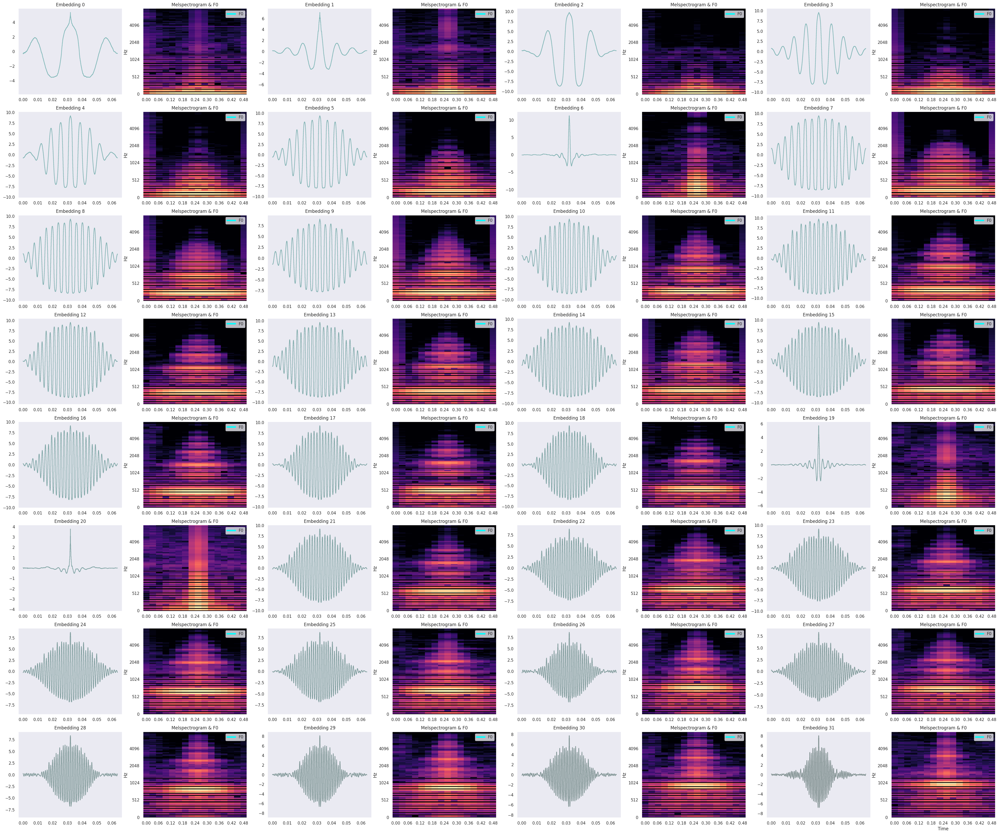

In [62]:
selected_emb_topk3 = torch.topk(zcs, 32)
selected_voiced_idx3 = selected_emb_topk3.indices
selected_emb3 = emb_data3.index_select(dim=0, index=selected_voiced_idx3)
selected_emb_color3 = torch.stack(
        [torch.full_like(selected_emb_topk3.values, 0.5), 
         selected_emb_topk3.values, selected_emb_topk3.values], 
        dim=-1).numpy()
visualize_speech_codebook(selected_emb3.numpy(), n=64, colors=selected_emb_color3)

In [63]:
model_path = '../linh_scb6.model.meld.step12k.pt'
torch.save(model.state_dict(), model_path)

In [64]:
np.save(
    '../linh_scb6.audio_embedding.meld.step1k.npy', 
    emb_data.numpy(), allow_pickle=True)

In [65]:
np.save(
    '../linh_scb6.audio_embedding.meld.step2k7.npy', emb_data2.numpy(), allow_pickle=True)

In [66]:
np.save(
    '../linh_scb6.audio_embedding.meld.step12k.npy', emb_data3.numpy(), allow_pickle=True)

In [68]:
emb_np3= emb_data3.numpy()
for i in selected_voiced_idx3:
    title=f'Voiced Embedding {i}'
    top_audio = AudioLibrosa(
        y=emb_np3[i], 
        sr=sr, title=title,
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(title)
    display(top_audio.player)

Voiced Embedding 259


Voiced Embedding 288


Voiced Embedding 206


Voiced Embedding 74


Voiced Embedding 33


Voiced Embedding 257


Voiced Embedding 56


Voiced Embedding 291


Voiced Embedding 241


Voiced Embedding 264


Voiced Embedding 119


Voiced Embedding 194


Voiced Embedding 369


Voiced Embedding 163


Voiced Embedding 344


Voiced Embedding 383


Voiced Embedding 262


Voiced Embedding 267


Voiced Embedding 283


Voiced Embedding 209


Voiced Embedding 359


Voiced Embedding 133


Voiced Embedding 17


Voiced Embedding 225


Voiced Embedding 58


Voiced Embedding 326


Voiced Embedding 332


Voiced Embedding 160


Voiced Embedding 32


Voiced Embedding 276


Voiced Embedding 51


Voiced Embedding 325


Voiced Embedding 259



Voiced Embedding 288



Voiced Embedding 206



Voiced Embedding 74



Voiced Embedding 33



Voiced Embedding 257



Voiced Embedding 56



Voiced Embedding 291



Voiced Embedding 241



Voiced Embedding 264



Voiced Embedding 119



Voiced Embedding 194



Voiced Embedding 369



Voiced Embedding 163



Voiced Embedding 344



Voiced Embedding 383



Voiced Embedding 262



Voiced Embedding 267



Voiced Embedding 283



Voiced Embedding 209



Voiced Embedding 359



Voiced Embedding 133



Voiced Embedding 17



Voiced Embedding 225



Voiced Embedding 58



Voiced Embedding 326



Voiced Embedding 332



Voiced Embedding 160



Voiced Embedding 32



Voiced Embedding 276



Voiced Embedding 51



Voiced Embedding 325



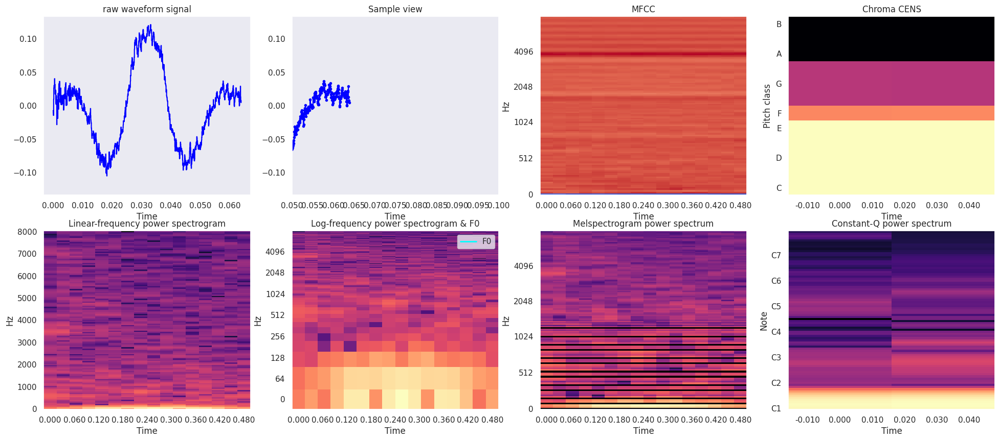

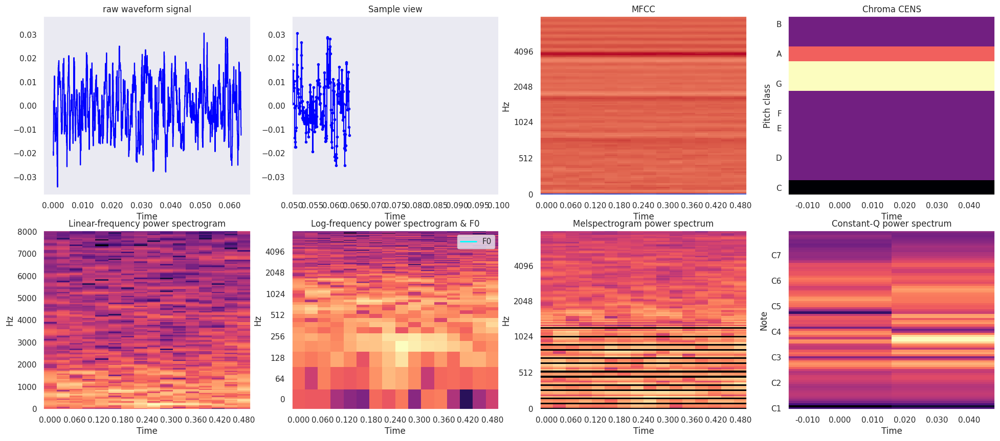

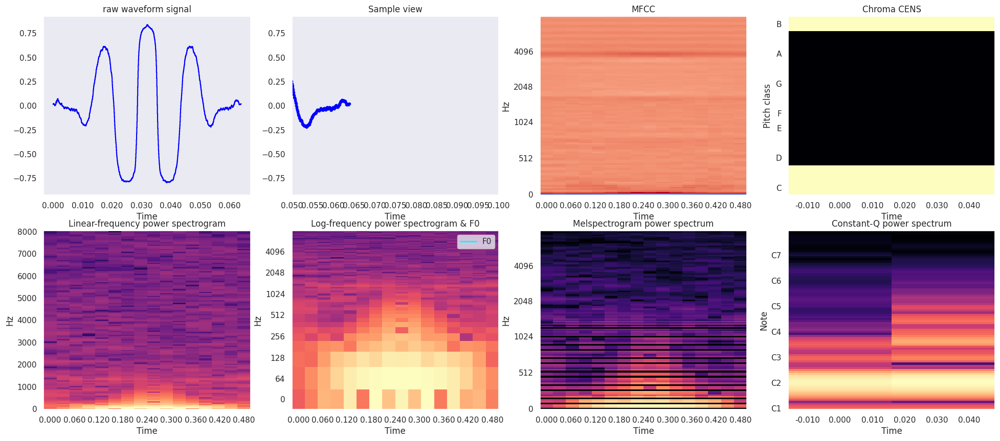

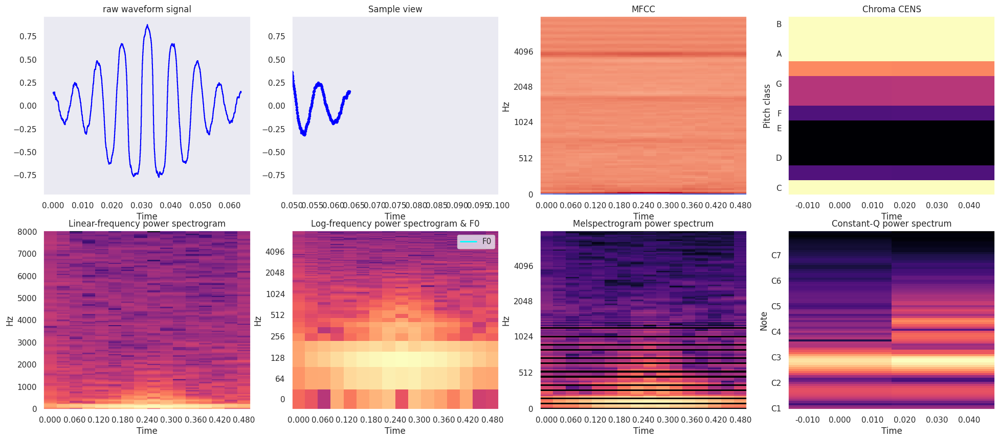

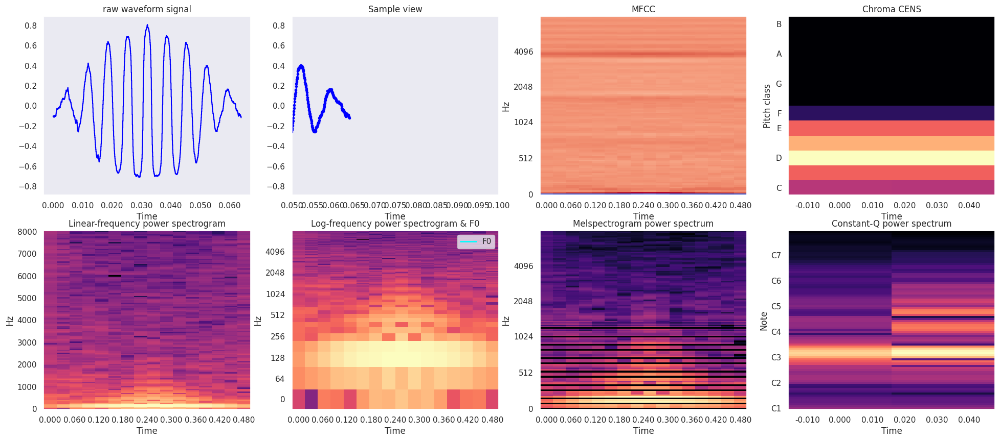

...

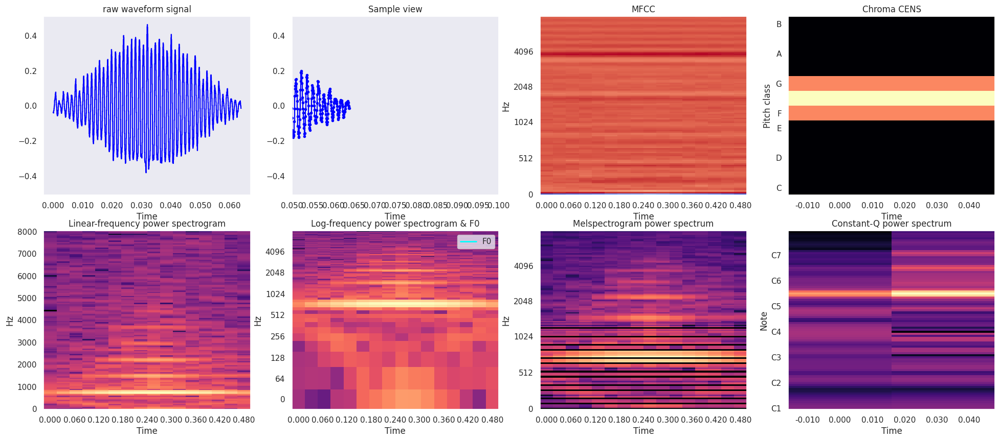

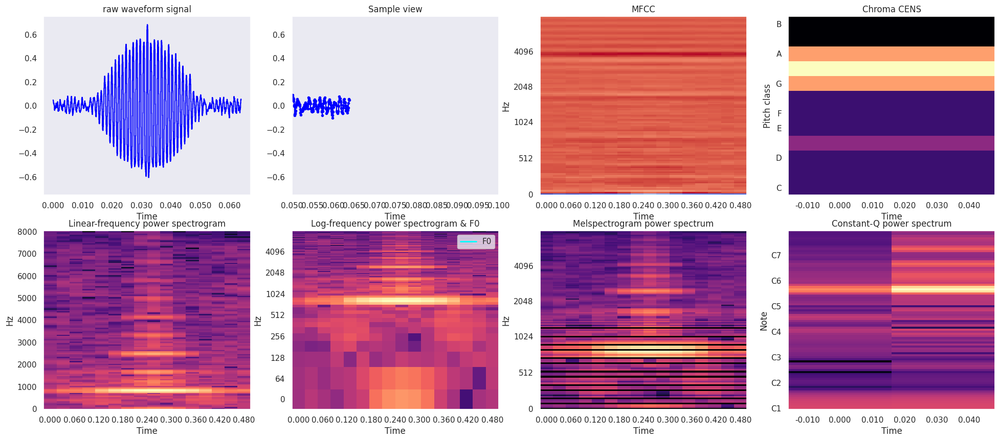

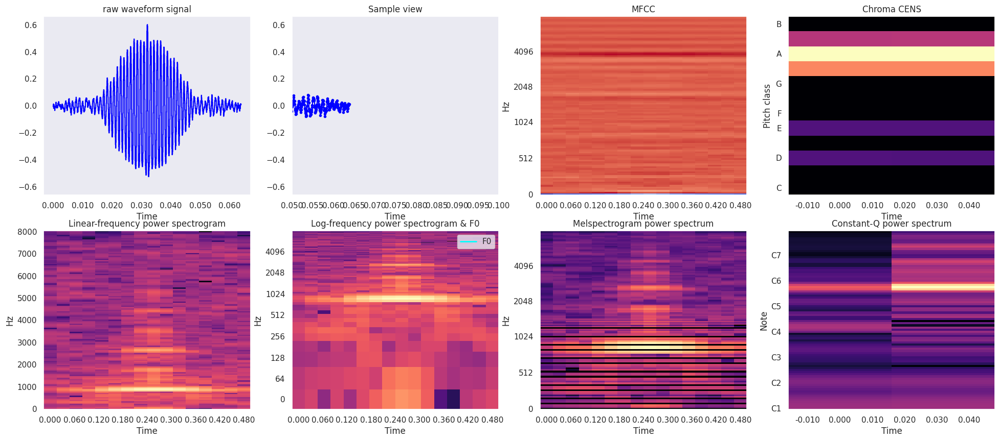

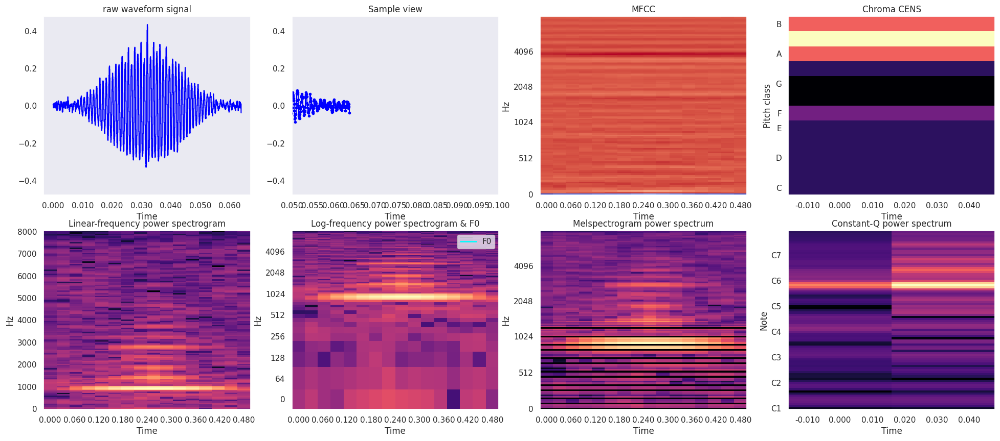

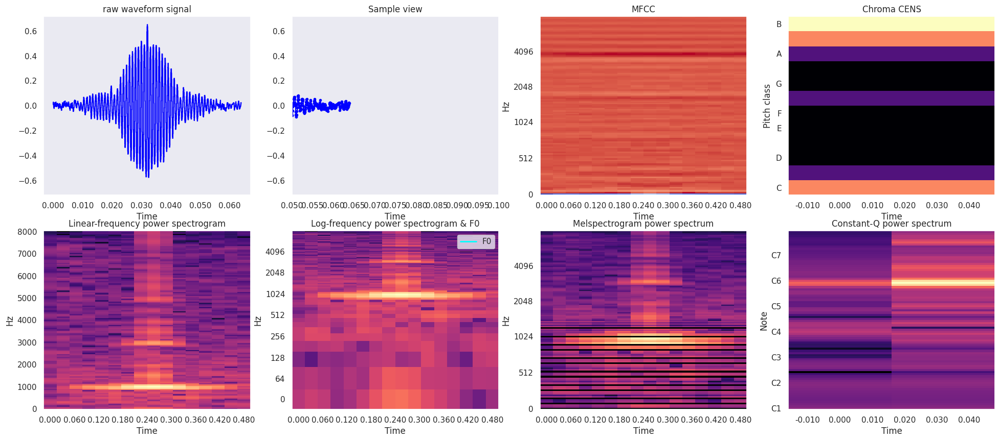

In [69]:
for ii in range(32):
    display_embedding(selected_voiced_idx3[ii])

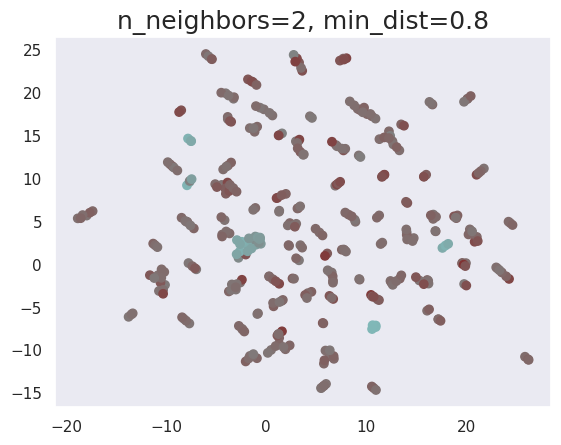

In [70]:
emb_data3 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data3)
k = 2
min_dist=0.8
visualize_embedding_umap(emb_data3, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

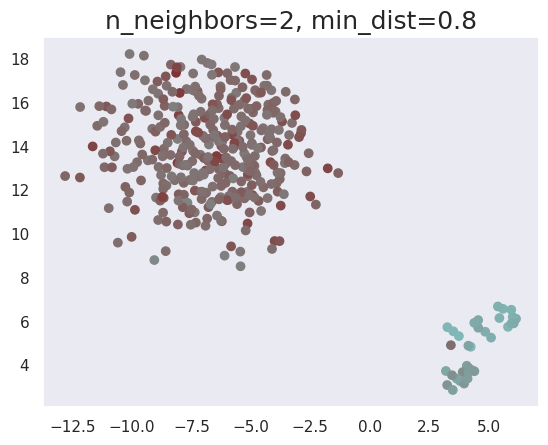

In [71]:
emb_data3 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data3)
k = 2
min_dist=0.8
visualize_embedding_umap(emb_data3, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

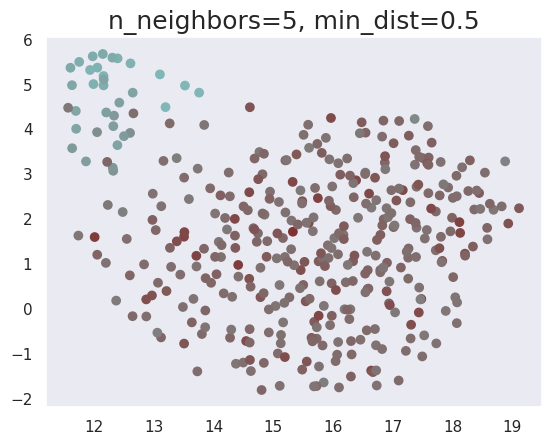

In [72]:
emb_data3 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data3)
k = 5
min_dist=0.5
visualize_embedding_umap(emb_data3, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

In [73]:
emb_data_cremad = np.load(
    '../linh_scb6.audio_embedding.crema_d.step2k7.npy', allow_pickle=True)

In [79]:
np.vstack([emb_data_cremad, emb_np3]).shape

(768, 1023)

In [87]:
def get_embedding_color2(    
    y: Tensor,
    n_fft: int = 1024,
    stride: int = 256
) -> Tensor:
    """Compute the zero-crossing score of the codebook embedding.

    Returns
    -------
    zcr : np.ndarray [shape=(..., 1, t)]
        ``zcr[..., 0, i]`` is the zero crossing score in frame ``i`` 
        with score in range [0,1]
    """
    crossings = zero_crossings(y, dtype=torch.float)
    zcrate = crossings.mean(dim=-1)
    nonzero_mean = torch.where(
        crossings>0, crossings, 0.0).mean(dim=-1)
    score = F.sigmoid(1 - 8*zcrate + 2*nonzero_mean)
    n = score.shape[0] //2

    dataset_idx = torch.concatenate([
        torch.full((n,), 0.3), torch.full((n,), 0.7)], dim=0)
    
    color = torch.stack(
        [dataset_idx, score, score], 
        dim=-1).numpy()
    return color, score

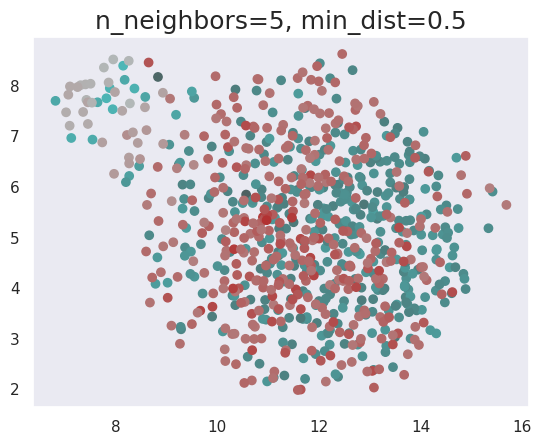

In [88]:
emb_2ds = torch.Tensor(np.vstack([emb_data_cremad, emb_np3]))
emb_color_2ds, zcs_2ds = get_embedding_color2(emb_2ds)
k = 5
min_dist=0.5
visualize_embedding_umap(emb_2ds, colors=emb_color_2ds, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

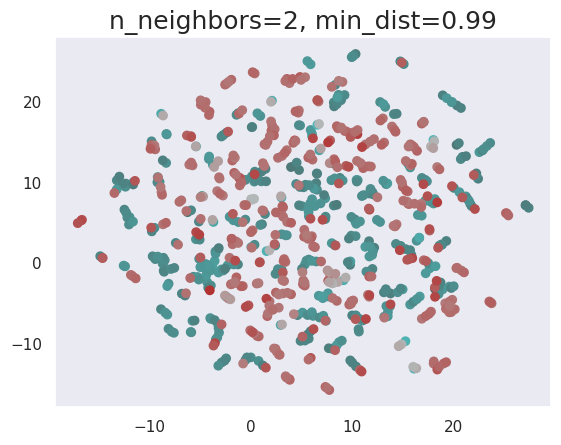

In [89]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_2ds, colors=emb_color_2ds, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

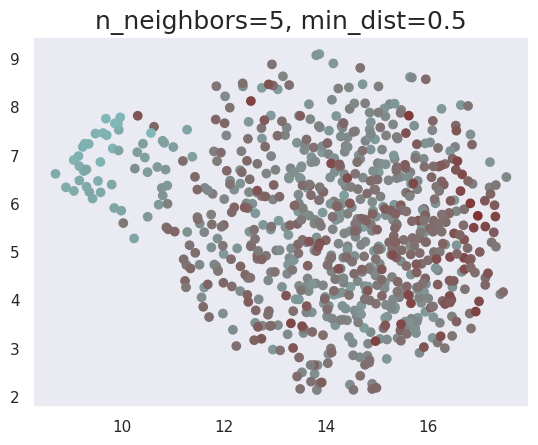

In [86]:
emb_2ds = torch.Tensor(np.vstack([emb_data_cremad, emb_np3]))
emb_color_2ds, zcs_2ds = get_embedding_color(emb_2ds)
k = 5
min_dist=0.5
visualize_embedding_umap(emb_2ds, colors=emb_color_2ds, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

In [94]:
from torchmetrics.classification import (
    MulticlassAccuracy, MulticlassPrecision, 
    MulticlassRecall, MulticlassF1Score, 
    MulticlassConfusionMatrix,
    MulticlassAUROC
)
from torchmetrics import MetricCollection
from pprint import pprint

@torch.no_grad
def report_metrics(model, labels=labels, 
                   test_loader=test_loader, device=device):
    n = len(labels)
    metrics = MetricCollection({
        'acc_unweighted': MulticlassAccuracy(num_classes=n), 
        'acc_weighted': MulticlassAccuracy(num_classes=n, average='weighted'), 
        
        'f1s': MulticlassF1Score(num_classes=n),  
        'uar': MulticlassRecall(num_classes=n, average='macro'), 
        'wap': MulticlassPrecision(num_classes=n, average='weighted'),
        
        'f1s_detail': MulticlassF1Score(num_classes=n, average=None),  
        'acc_detail': MulticlassAccuracy(num_classes=n, average=None), 
        'precision_detail': MulticlassPrecision(num_classes=n, average=None),
        'recall_detail': MulticlassRecall(num_classes=n, average=None), 
        'rocauc': MulticlassAUROC(num_classes=n, average=None, thresholds=None)
    }
    # , compute_groups=[['acc', 'f1s', 'wap'], ['uap', 'uar']]
                              ).to(device)
    confusion_matrix = MulticlassConfusionMatrix(num_classes=n).to(device)
    model.eval()
    correct = 0
    total = 0
    for data, target in test_loader:
        total += len(target)
        
        data = data.to(device)
        target = target.to(device)
        logits, _,_,_ = model(data)
        del data
        gc.collect()
        torch.cuda.empty_cache()
        probs = F.softmax(logits.squeeze(), dim=-1)
        pred = probs.argmax(dim=-1)
        correct += pred.eq(target).sum().item()
        
        metrics.update(probs, target)
        confusion_matrix.update(pred, target)
        
        del target
        gc.collect()
        torch.cuda.empty_cache()
    print(f'Correct: {correct}/{total} ({correct/total:.4f})')
    return metrics, confusion_matrix

In [95]:
metrics, confusion_matrix = report_metrics(
    model, labels=labels, device=device)
pprint(metrics.compute())
confusion_matrix.compute()

Correct: 661/1696 (0.3897)
{'acc_detail': tensor([0.4856, 0.0688, 0.1680, 0.4435], device='cuda:0'),
 'acc_unweighted': tensor(0.2914, device='cuda:0'),
 'acc_weighted': tensor(0.3897, device='cuda:0'),
 'f1s': tensor(0.2833, device='cuda:0'),
 'f1s_detail': tensor([0.5382, 0.0812, 0.2205, 0.2931], device='cuda:0'),
 'precision_detail': tensor([0.6037, 0.0991, 0.3209, 0.2189], device='cuda:0'),
 'recall_detail': tensor([0.4856, 0.0688, 0.1680, 0.4435], device='cuda:0'),
 'rocauc': tensor([0.5882, 0.5027, 0.6340, 0.5229], device='cuda:0'),
 'uar': tensor(0.2914, device='cuda:0'),
 'wap': tensor(0.4351, device='cuda:0')}


tensor([[454,  63,  47, 371],
        [ 74,  11,  10,  65],
        [ 81,  22,  43, 110],
        [143,  15,  34, 153]], device='cuda:0')